<a href="https://colab.research.google.com/github/bikiram/Remote-Sensing/blob/main/Time_series_ndvi_tracking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import numpy as np 
import matplotlib.pyplot as plt 
import numpy as np 
from osgeo import gdal
from matplotlib import pyplot as plt
import os
from pylab import *
import matplotlib as mpl

# Downloaded and extracted the tiff files of the are of interest 
1. Whole Ukraine
2. East Ukraine
3. West Ukraine
4.Creamea
5. Donbas
6.Kyiv

In [13]:
# whole ukrain
whole_ukr_2021_path ="/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/remote sensing 2021_mask layer/Mask 2021"
whole_ukr_2022_path ="/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/croppe"
# east ukraine
east_ukr_2021_path="/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/east_west_ukr_2021/east 21"
east_ukr_2022_path="/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/enw/east"
# west ukraine
west_ukr_2021_path="/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/east_west_ukr_2021/west 21"
west_ukr_2022_path="/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/enw/west"
#creamea
creamea_ukr_2021_path="/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/creamea 21"
creamea_ukr_2022_path="/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/cdk22/creamea"
#donbas
donbas_ukr_2021_path="/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/donbas 21"
donbas_ukr_2022_path="/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/cdk22/donbas"

#kyiv
kyiv_2021="/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/Kyiv 21"
kyiv_2022="/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/cdk22/kyiv"

In [14]:
path=[whole_ukr_2021_path,whole_ukr_2022_path,east_ukr_2021_path,east_ukr_2022_path,west_ukr_2021_path,west_ukr_2022_path,creamea_ukr_2021_path,creamea_ukr_2022_path,donbas_ukr_2021_path,donbas_ukr_2022_path,kyiv_2021,kyiv_2022]

# The following panel We have plotted the image of the area of interest and have saved the mean value of the NDVI for the Time series data. Modis has observed the regions after 16 days and the date of cooresponding observation can be seen in the title of each Image. In the firsty panel we have analysed the Whole ukarine and region and plotted the time series data to visualize the change in two different year.

In th nxt following panels We have done the same analysis  for diffrent region and visualized the change. 

/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/remote sensing 2021_mask layer/Mask 2021/Mask_01_01_21.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/remote sensing 2021_mask layer/Mask 2021/mask_01_17_21.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/remote sensing 2021_mask layer/Mask 2021/mask_02_02_21.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/remote sensing 2021_mask layer/Mask 2021/mask_02_18_21.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/remote sensing 2021_mask layer/Mask 2021/mask_03_06_21.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/remote sensing 2021_mask layer/Mask 2021/mask_03_22_21.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/remote sensing 2021_mask layer/Mask 2021/mask_04_07_21.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/remote sensing 2021_mask layer/Mask 2021/ma

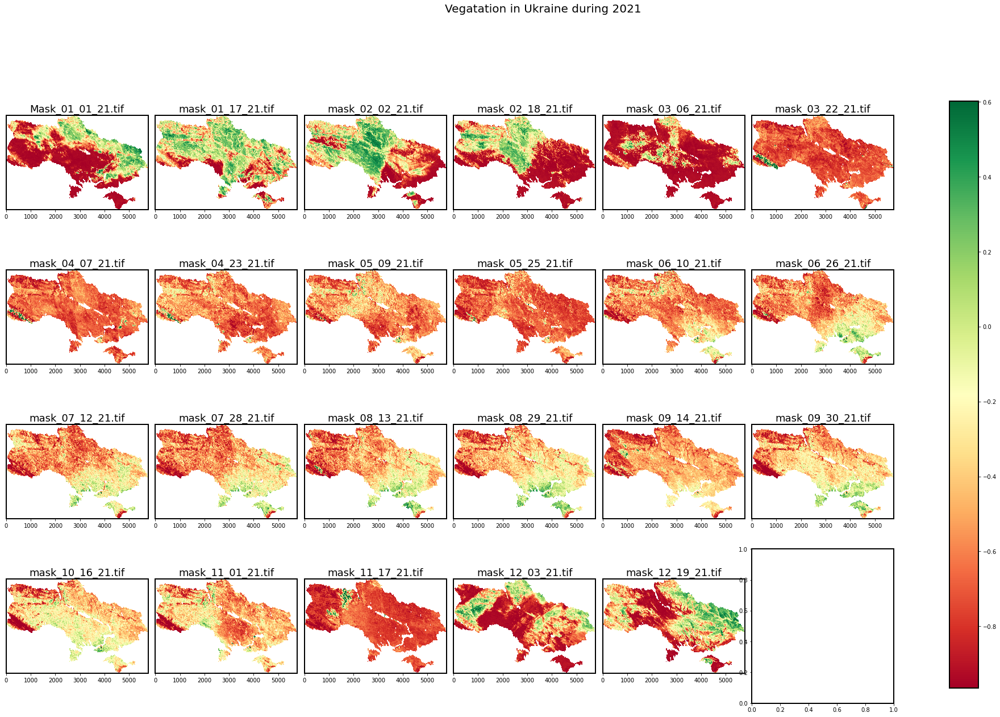

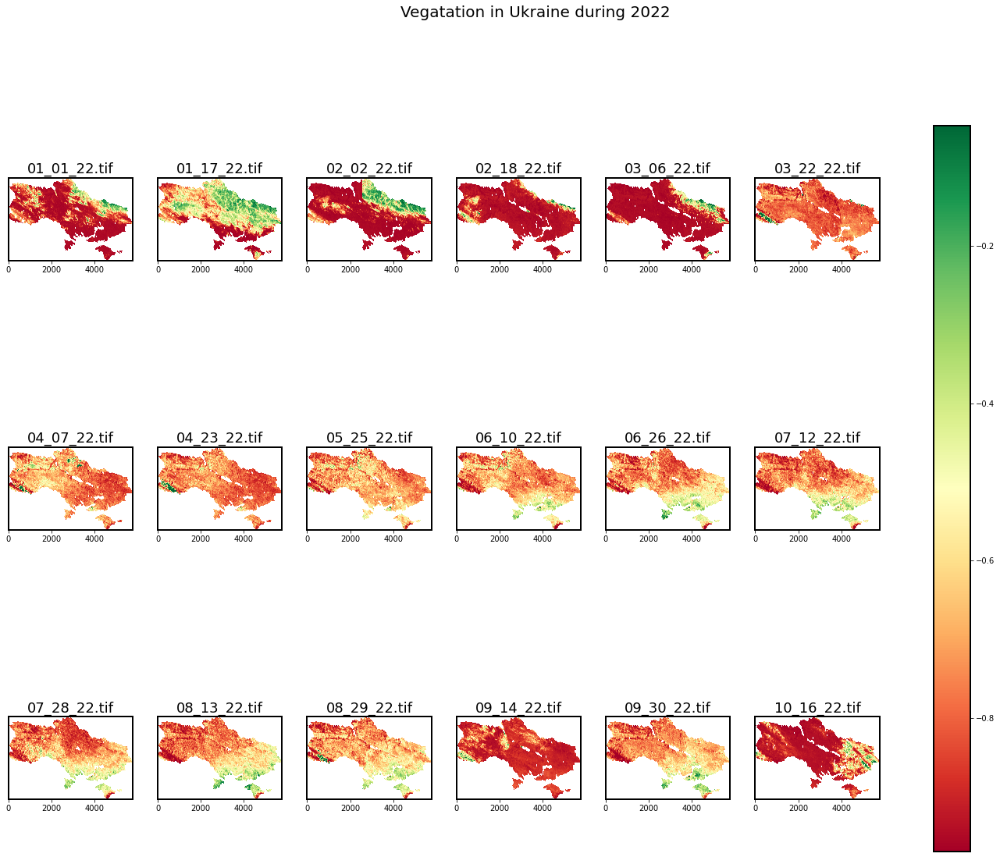

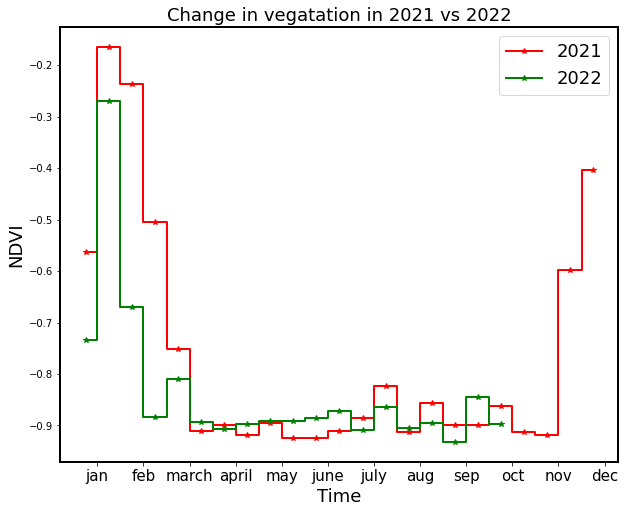

In [32]:
dt=[]
data=[]
change_data=[0,2,4,6,8]

# chnage range of i to select desired data set

for i in range(0,2,1):
  os.chdir(path[i])
  def read_files(file_path):
    with open(file_path, 'r') as file:
        print(file.read())
  # Iterate over all the files in the directory
  for file in os.listdir():
    if file.endswith('.tif'):
        # Create the filepath of particular file
        file_path=os.path.join(path[i],file)
        data.append(file_path)
        dt.append(file)
        print(file_path)

ds2=[]
m2=[]
std2=[]
for i in range(0,len(data),1):
    ds = gdal.Open(data[i]).ReadAsArray()
    ds[ds == 0] = np.nan
    a=np.nanmin(ds)
    b=np.nanmax(ds)
    #print(a)
    c=-1
    d=1
    e=ds-a
    f=e/(b-a)
    g=f*(d-c)
    hh=g+c
    ds2.append(hh)
    #vmin=np.nanquantile(hh,0.05)
    #vmax=np.nanquantile(hh,0.99)
    #im=axs[i].imshow(hh,vmax=vmax,vmin=vmin,cmap='RdYlGn')
    #axs[i].set_yticks([])
    mean=np.nanmean(hh)
    std=np.nanstd(hh)
    m2.append(mean)
    std2.append(std)
    #print(mean,std,i,dt[i])

fig, axs = plt.subplots(4,6, figsize=(35, 20), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = 0.001, wspace=0.05)
fig.suptitle("Vegatation in Ukraine during 2021", fontsize=20)
axs = axs.ravel()

mpl.rcParams['lines.linewidth'] = 2
rc('axes', linewidth=2)
for i in range(0,23,1):
    vmin=np.nanquantile(ds2[i],0.05)
    vmax=np.nanquantile(ds2[i],0.99)
    im=axs[i].imshow(ds2[i],vmax=vmax,vmin=vmin,cmap='RdYlGn')
    axs[i].set_title(dt[i],fontsize=18)
    axs[i].set_yticks([])

cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.95)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/ukraine_2021_vagetation.jpg',dpi=200)

fig, axs = plt.subplots(3,6, figsize=(25, 18), facecolor='w', edgecolor='k')
#fig.subplots_adjust(hspace = 0.0001, wspace=0.001)
axs = axs.ravel()
fig.suptitle("Vegatation in Ukraine during 2022", fontsize=20)

mpl.rcParams['lines.linewidth'] = 2
rc('axes', linewidth=2)
for i in range(0,18,1):
      print(i,dt[i+23])
      vmin=np.nanquantile(ds2[i+23],0.05)
      vmax=np.nanquantile(ds2[i+23],0.99)
      #rc('axes', linewidth=4)
      im=axs[i].imshow(ds2[i+23],vmax=vmax,vmin=vmin,cmap='RdYlGn')
      axs[i].set_title(dt[i+23],fontsize=18)
      axs[i].set_yticks([])
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.95)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/ukraine_2022_vagetation_images.jpg',dpi=400)

x=np.arange(0,23,1)
plt.figure(figsize=(10,8))
#plt.plot(x, m2[0:23], '*-',color='r')
#plt.plot(x[0:19], m2[23:len(dt)], '*-',color='green')
plt.step(x, m2[0:23],'*-', where='mid',color='r',label='2021')
#plt.errorbar(x, m2[0:23],yerr=std2[0:23])
plt.step(x[0:19], m2[23:len(dt)], '*-', where='mid',color='green',label='2022')
#plt.plot(x,m2,'*-')
plt.ylabel('NDVI',fontsize=18)
plt.xlabel('Time',fontsize=18)
plt.title('Change in vegatation in 2021 vs 2022',fontsize=18)
plt.legend(loc='upper right',fontsize=18)
plt.xticks([0.5,2.5,4.5,6.5,8.5,10.5,12.5,14.5,16.5,18.5,20.5,22.5],['jan','feb','march','april','may','june','july','aug','sep','oct','nov','dec'],fontsize=15)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/ukr_vegatation_change_21_22.jpg',dpi=400)

0 01_01_22_e.tif
1 01_17_22_e.tif
2 02_02_22_e.tif
3 02_18_22_e.tif
4 03_06_22_e.tif
5 03_22_22_e.tif
6 04_07_22_e.tif
7 04_23_22_e.tif
8 05_25_22_e.tif
9 06_10_22_e.tif
10 06_26_22_e.tif
11 07_12_22_e.tif
12 07_28_22_e.tif
13 08_13_22_e.tif
14 08_29_22_e.tif
15 09_14_22_e.tif
16 09_30_22_e.tif
17 10_16_22_e.tif


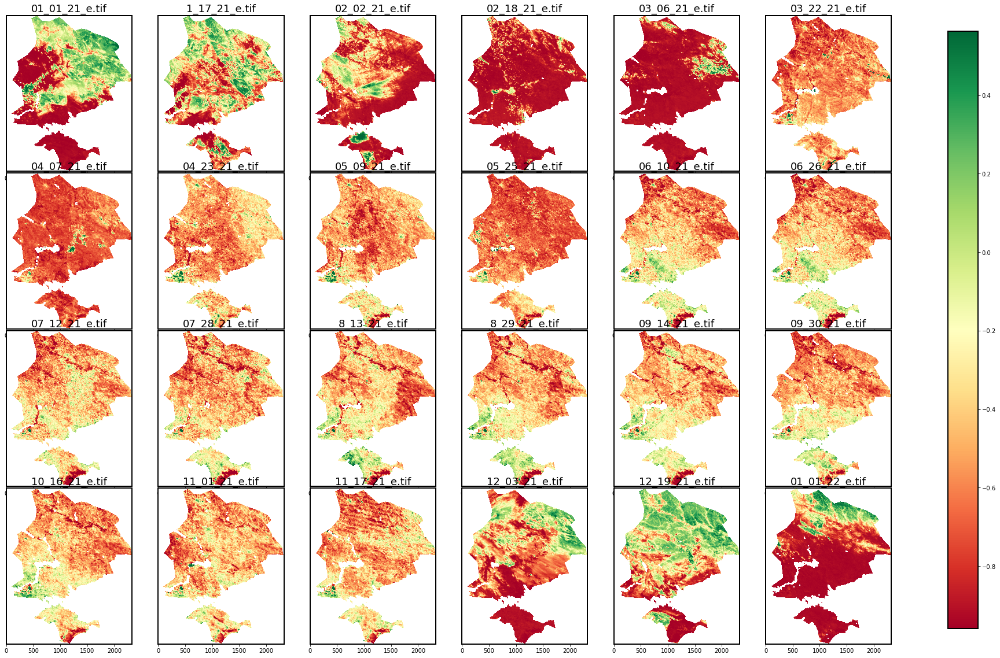

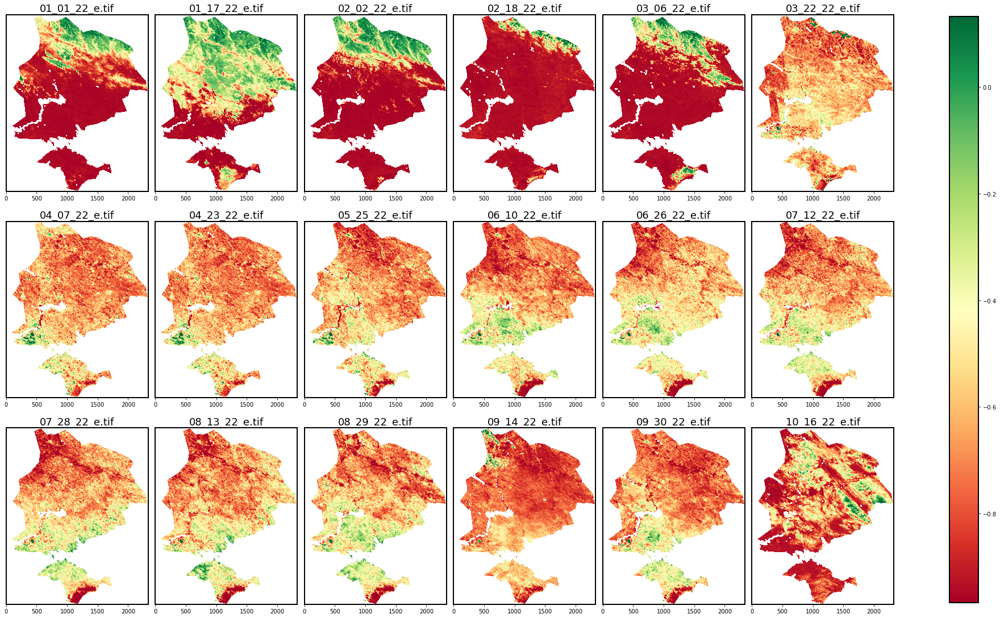

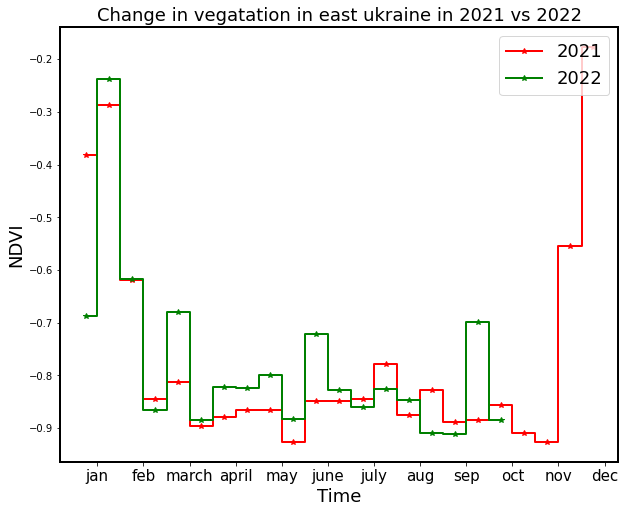

In [33]:
dt=[]
data=[]

# chnage range of i to select desired data set

for i in range(0,2,1):
  os.chdir(path[i+2])
  def read_files(file_path):
    with open(file_path, 'r') as file:
        print(file.read())
  # Iterate over all the files in the directory
  for file in os.listdir():
    if file.endswith('.tif'):
        # Create the filepath of particular file
        file_path=os.path.join(path[i+2],file)
        data.append(file_path)
        dt.append(file)

ds2=[]
m2=[]
std2=[]
for i in range(0,len(data),1):
    ds = gdal.Open(data[i]).ReadAsArray()
    ds[ds == 0] = np.nan
    a=np.nanmin(ds)
    b=np.nanmax(ds)
    #print(a)
    c=-1
    d=1
    e=ds-a
    f=e/(b-a)
    g=f*(d-c)
    hh=g+c
    ds2.append(hh)
    #vmin=np.nanquantile(hh,0.05)
    #vmax=np.nanquantile(hh,0.99)
    #im=axs[i].imshow(hh,vmax=vmax,vmin=vmin,cmap='RdYlGn')
    #axs[i].set_yticks([])
    mean=np.nanmean(hh)
    std=np.nanstd(hh)
    m2.append(mean)
    std2.append(std)
    #print(mean,std,i,dt[i])


mpl.rcParams['lines.linewidth'] = 2
rc('axes', linewidth=2)

fig, axs = plt.subplots(4,6, figsize=(35, 20), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = 0.01, wspace=0.05)
axs = axs.ravel()
for i in range(0,24,1):
    vmin=np.nanquantile(ds2[i],0.05)
    vmax=np.nanquantile(ds2[i],0.99)
    im=axs[i].imshow(ds2[i],vmax=vmax,vmin=vmin,cmap='RdYlGn')
    axs[i].set_title(dt[i],fontsize=18)
    axs[i].set_yticks([])
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.95)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/east_ukraine_2021_vagetation_images.jpg',dpi=400)
#plt.clf()

fig, axs = plt.subplots(3,6, figsize=(35, 20), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = 0.01, wspace=0.05)
axs = axs.ravel()
for i in range(0,18,1):
      print(i,dt[i+23])
      vmin=np.nanquantile(ds2[i+23],0.05)
      vmax=np.nanquantile(ds2[i+23],0.99)
      #rc('axes', linewidth=4)
      im=axs[i].imshow(ds2[i+23],vmax=vmax,vmin=vmin,cmap='RdYlGn')
      axs[i].set_title(dt[i+23],fontsize=18)
      axs[i].set_yticks([])
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.95)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/east_ukraine_2022_vagetation_images.jpg',dpi=400)

x=np.arange(0,23,1)
plt.figure(figsize=(10,8))
#plt.plot(x, m2[0:23], '*-',color='r')
#plt.plot(x[0:19], m2[23:len(dt)], '*-',color='green')
plt.step(x, m2[0:23],'*-', where='mid',color='r',label='2021')
#plt.errorbar(x, m2[0:23],yerr=std2[0:23])
plt.step(x[0:19], m2[23:len(dt)], '*-', where='mid',color='green',label='2022')
#plt.plot(x,m2,'*-')
plt.ylabel('NDVI',fontsize=18)
plt.xlabel('Time',fontsize=18)
plt.title('Change in vegatation in east ukraine in 2021 vs 2022',fontsize=18)
plt.legend(loc='upper right',fontsize=18)
plt.xticks([0.5,2.5,4.5,6.5,8.5,10.5,12.5,14.5,16.5,18.5,20.5,22.5],['jan','feb','march','april','may','june','july','aug','sep','oct','nov','dec'],fontsize=15)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/east_ukr_vegatation_change_21_22.jpg',dpi=400)

/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/east_west_ukr_2021/west 21
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/east_west_ukr_2021/west 21/01_01_21_west.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/east_west_ukr_2021/west 21/01_17_21_w.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/east_west_ukr_2021/west 21/02_02_21_w.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/east_west_ukr_2021/west 21/02_18_21_w.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/east_west_ukr_2021/west 21/03_06_21_w.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/east_west_ukr_2021/west 21/03_22_21_w.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/east_west_ukr_2021/west 21/04_07_21_w.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/east_west_ukr_2021/west 21/04_23_21_w.tif
/content/drive/My Driv

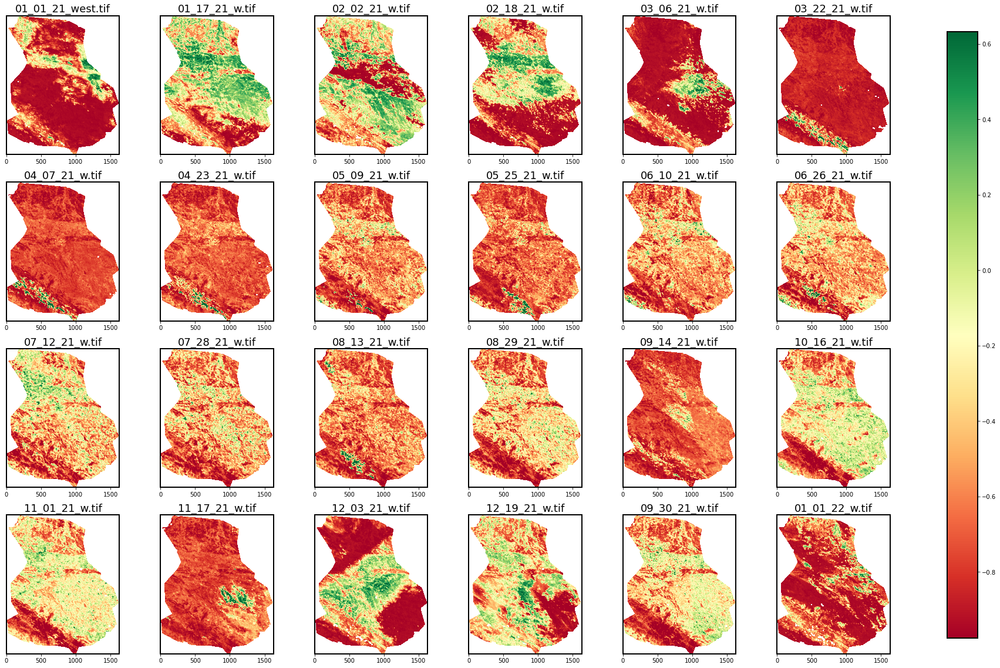

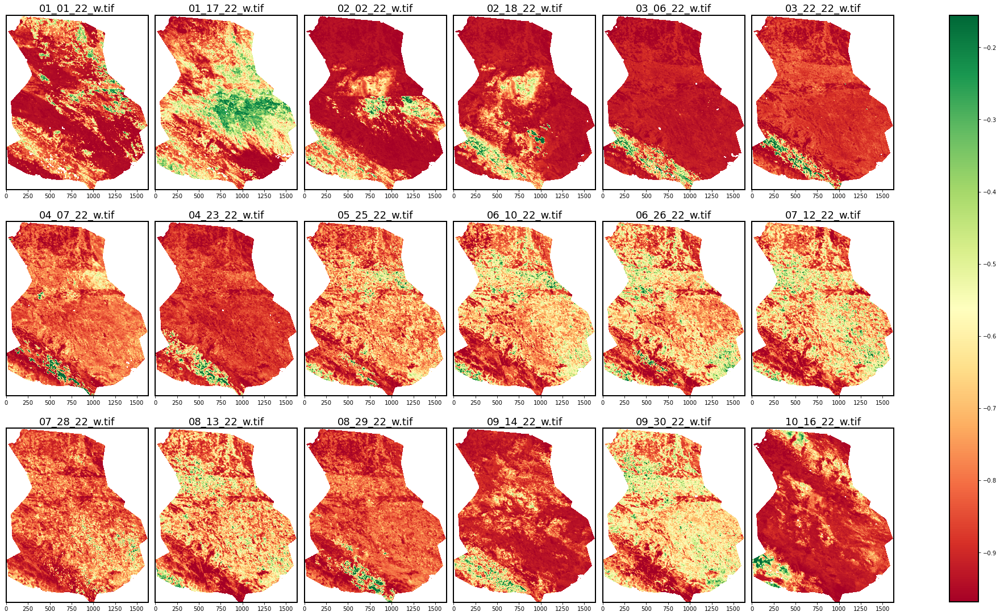

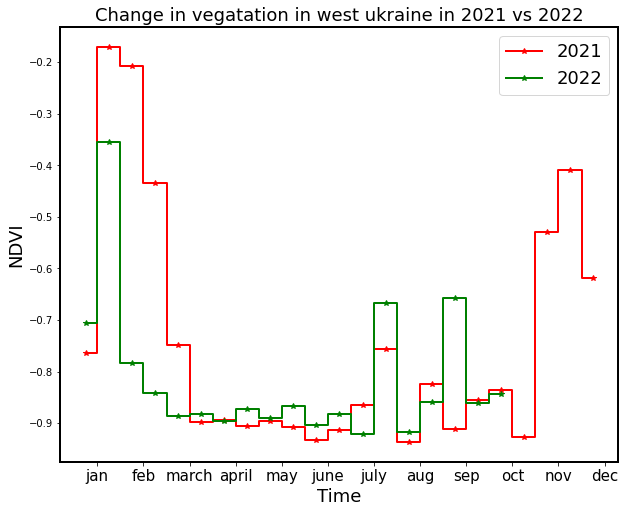

In [34]:
dt=[]
data=[]

# chnage range of i to select desired data set

for i in range(0,2,1):
  os.chdir(path[i+4])
  print(path[i+4])
  def read_files(file_path):
    with open(file_path, 'r') as file:
        print(file.read())
  # Iterate over all the files in the directory
  for file in os.listdir():
    if file.endswith('.tif'):
        # Create the filepath of particular file
        file_path=os.path.join(path[i+4],file)
        print(file_path)
        data.append(file_path)
        dt.append(file)
ds2=[]
m2=[]
std2=[]
for i in range(0,len(data),1):
    ds = gdal.Open(data[i]).ReadAsArray()
    ds[ds == 0] = np.nan
    a=np.nanmin(ds)
    b=np.nanmax(ds)
    #print(a)
    c=-1
    d=1
    e=ds-a
    f=e/(b-a)
    g=f*(d-c)
    hh=g+c
    ds2.append(hh)
    #vmin=np.nanquantile(hh,0.05)
    #vmax=np.nanquantile(hh,0.99)
    #im=axs[i].imshow(hh,vmax=vmax,vmin=vmin,cmap='RdYlGn')
    #axs[i].set_yticks([])
    mean=np.nanmean(hh)
    std=np.nanstd(hh)
    m2.append(mean)
    std2.append(std)
    #print(mean,std,i,dt[i])
mpl.rcParams['lines.linewidth'] = 2
rc('axes', linewidth=2)

fig, axs = plt.subplots(4,6, figsize=(35, 20), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = 0.2, wspace=0.05)
axs = axs.ravel()
for i in range(0,24,1):
    vmin=np.nanquantile(ds2[i],0.05)
    vmax=np.nanquantile(ds2[i],0.99)
    im=axs[i].imshow(ds2[i],vmax=vmax,  vmin=vmin,  cmap='RdYlGn')
    axs[i].set_title(dt[i],fontsize=18)
    axs[i].set_yticks([])
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.95)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/west_ukraine_2021_vagetation_images.jpg',dpi=400)
#plt.clf()

fig, axs = plt.subplots(3,6, figsize=(35, 20), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = 0.01, wspace=0.05)
axs = axs.ravel()
for i in range(0,18,1):
      print(i,dt[i+23])
      vmin=np.nanquantile(ds2[i+23],0.05)
      vmax=np.nanquantile(ds2[i+23],0.99)
      #rc('axes', linewidth=4)
      im=axs[i].imshow(ds2[i+23],vmax=vmax,vmin=vmin,cmap='RdYlGn')
      axs[i].set_title(dt[i+23],fontsize=18)
      axs[i].set_yticks([])
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.95)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/west_ukraine_2022_vagetation_images.jpg',dpi=400)

x=np.arange(0,23,1)
plt.figure(figsize=(10,8))
#plt.plot(x, m2[0:23], '*-',color='r')
#plt.plot(x[0:19], m2[23:len(dt)], '*-',color='green')
plt.step(x, m2[0:23],'*-', where='mid',color='r',label='2021')
#plt.errorbar(x, m2[0:23],yerr=std2[0:23])
plt.step(x[0:19], m2[23:len(dt)], '*-', where='mid',color='green',label='2022')
#plt.plot(x,m2,'*-')
plt.ylabel('NDVI',fontsize=18)
plt.xlabel('Time',fontsize=18)
plt.title('Change in vegatation in west ukraine in 2021 vs 2022',fontsize=18)
plt.legend(loc='upper right',fontsize=18)
plt.xticks([0.5,2.5,4.5,6.5,8.5,10.5,12.5,14.5,16.5,18.5,20.5,22.5],['jan','feb','march','april','may','june','july','aug','sep','oct','nov','dec'],fontsize=15)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/west_ukr_vegatation_change_21_22.jpg',dpi=400)

/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/donbas 21
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/donbas 21/1_1_21_don.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/donbas 21/1_17_21_don.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/donbas 21/2_2_21_don.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/donbas 21/2_18_21_don.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/donbas 21/3_6_21_don.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/donbas 21/3_22_21_don.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/donbas 21/4_7_21_don.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/donbas 21/4_23_21_don.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/donbas 21/5_9_21_don.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/donbas 21/5_2

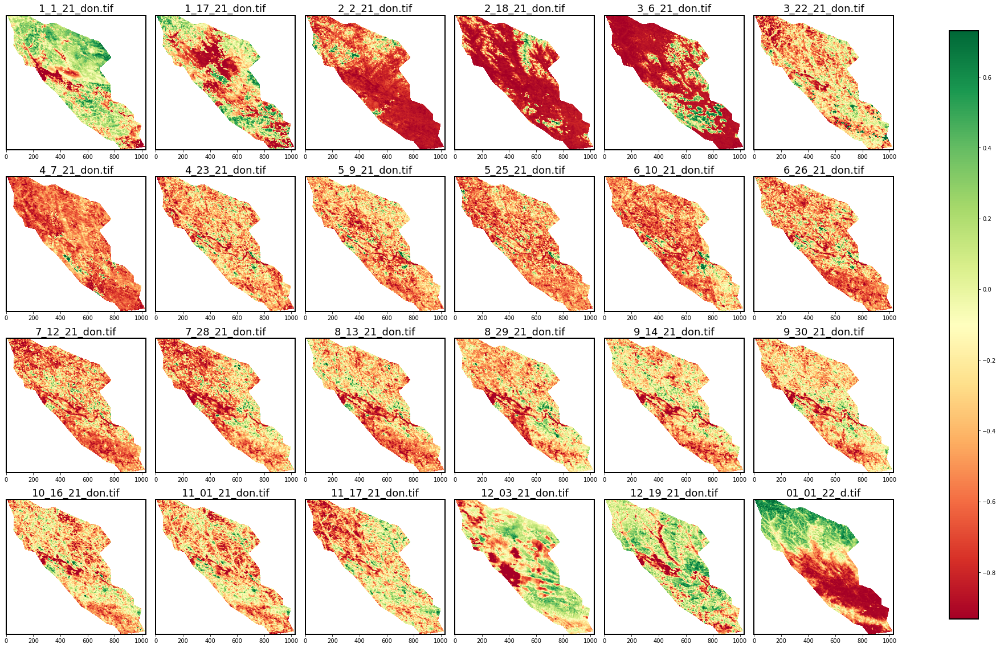

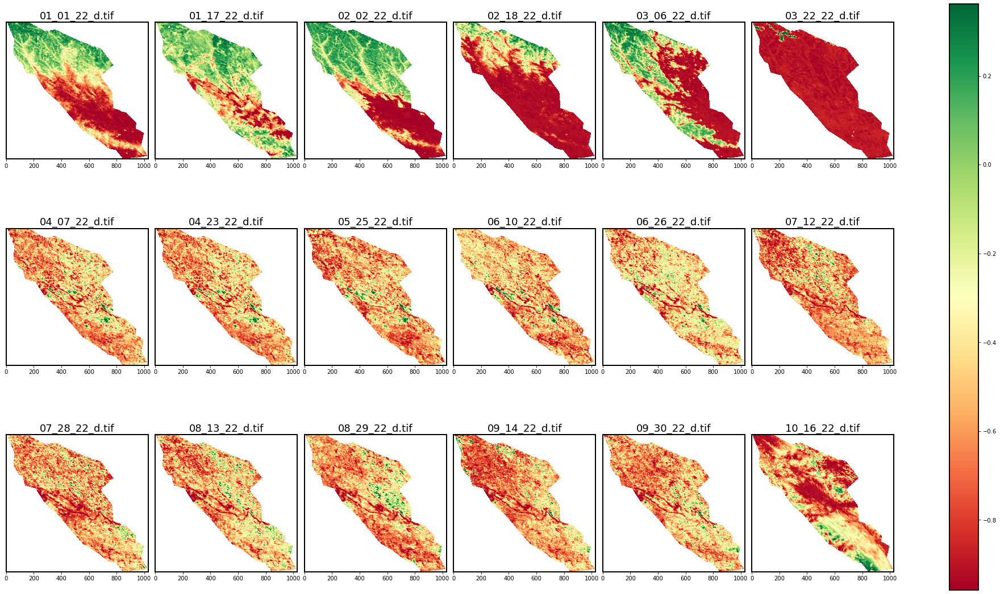

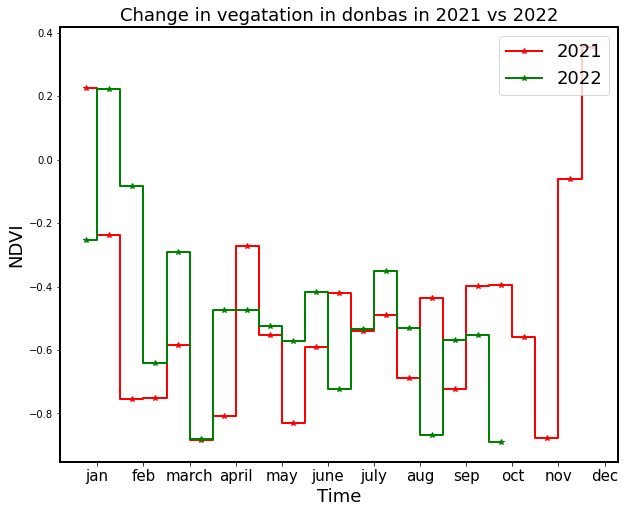

In [35]:
dt=[]
data=[]

# chnage range of i to select desired data set

for i in range(0,2,1):
  os.chdir(path[i+8])
  print(path[i+8])
  def read_files(file_path):
    with open(file_path, 'r') as file:
        print(file.read())
  # Iterate over all the files in the directory
  for file in os.listdir():
    if file.endswith('.tif'):
        # Create the filepath of particular file
        file_path=os.path.join(path[i+8],file)
        print(file_path)
        data.append(file_path)
        dt.append(file)
ds2=[]
m2=[]
std2=[]
for i in range(0,len(data),1):
    ds = gdal.Open(data[i]).ReadAsArray()
    ds[ds == 0] = np.nan
    a=np.nanmin(ds)
    b=np.nanmax(ds)
    #print(a)
    c=-1
    d=1
    e=ds-a
    f=e/(b-a)
    g=f*(d-c)
    hh=g+c
    ds2.append(hh)
    #vmin=np.nanquantile(hh,0.05)
    #vmax=np.nanquantile(hh,0.99)
    #im=axs[i].imshow(hh,vmax=vmax,vmin=vmin,cmap='RdYlGn')
    #axs[i].set_yticks([])
    mean=np.nanmean(hh)
    std=np.nanstd(hh)
    m2.append(mean)
    std2.append(std)
    #print(mean,std,i,dt[i])
mpl.rcParams['lines.linewidth'] = 2
rc('axes', linewidth=2)

fig, axs = plt.subplots(4,6, figsize=(35, 20), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = 0.2, wspace=0.05)
axs = axs.ravel()
for i in range(0,24,1):
    vmin=np.nanquantile(ds2[i],0.05)
    vmax=np.nanquantile(ds2[i],0.99)
    im=axs[i].imshow(ds2[i],vmax=vmax,  vmin=vmin,  cmap='RdYlGn')
    axs[i].set_title(dt[i],fontsize=18)
    axs[i].set_yticks([])
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.95)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/Donbas_2021_vagetation_images.jpg',dpi=400)
#plt.clf()

fig, axs = plt.subplots(3,6, figsize=(35, 20), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = 0.01, wspace=0.05)
axs = axs.ravel()
for i in range(0,18,1):
      print(i,dt[i+23])
      vmin=np.nanquantile(ds2[i+23],0.05)
      vmax=np.nanquantile(ds2[i+23],0.99)
      #rc('axes', linewidth=4)
      im=axs[i].imshow(ds2[i+23],vmax=vmax,vmin=vmin,cmap='RdYlGn')
      axs[i].set_title(dt[i+23],fontsize=18)
      axs[i].set_yticks([])
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.95)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/donbas_2022_vagetation_images.jpg',dpi=400)

x=np.arange(0,23,1)
plt.figure(figsize=(10,8))
#plt.plot(x, m2[0:23], '*-',color='r')
#plt.plot(x[0:19], m2[23:len(dt)], '*-',color='green')
plt.step(x, m2[0:23],'*-', where='mid',color='r',label='2021')
#plt.errorbar(x, m2[0:23],yerr=std2[0:23])
plt.step(x[0:19], m2[23:len(dt)], '*-', where='mid',color='green',label='2022')
#plt.plot(x,m2,'*-')
plt.ylabel('NDVI',fontsize=18)
plt.xlabel('Time',fontsize=18)
plt.title('Change in vegatation in donbas in 2021 vs 2022',fontsize=18)
plt.legend(loc='upper right',fontsize=18)
plt.xticks([0.5,2.5,4.5,6.5,8.5,10.5,12.5,14.5,16.5,18.5,20.5,22.5],['jan','feb','march','april','may','june','july','aug','sep','oct','nov','dec'],fontsize=15)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/donbas_vegatation_change_21_22.jpg',dpi=400)

/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/creamea 21
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/creamea 21/1_1_21_cr.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/creamea 21/1_17_21_cr.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/creamea 21/2_2_21_cr.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/creamea 21/2_18_21_cr.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/creamea 21/3_6_21_cr.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/creamea 21/3_22_21_cr.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/creamea 21/4_7_21_cr.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/creamea 21/4_23_21_cr.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/creamea 21/5_9_21_cr.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/creamea 21/5

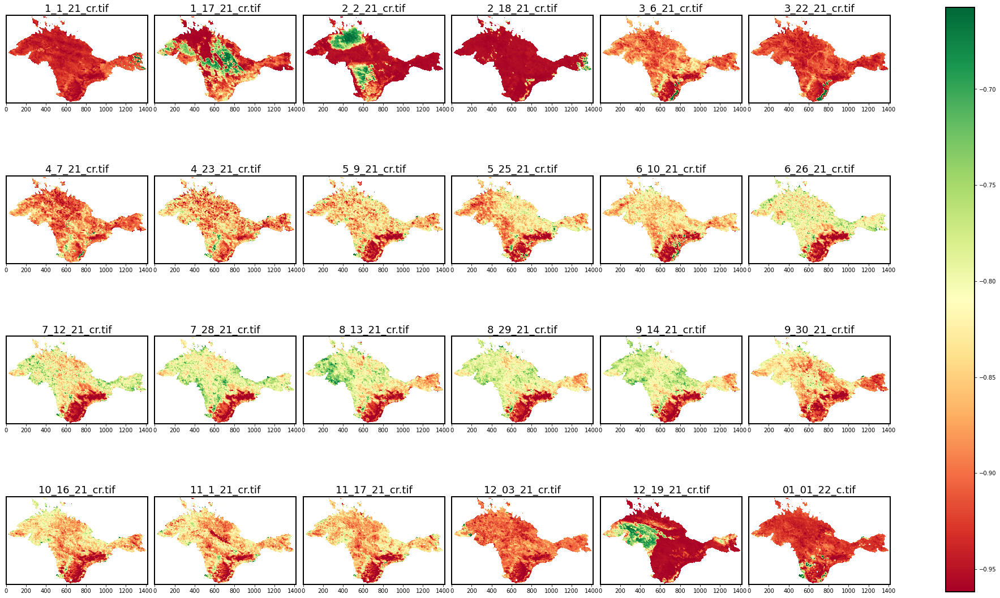

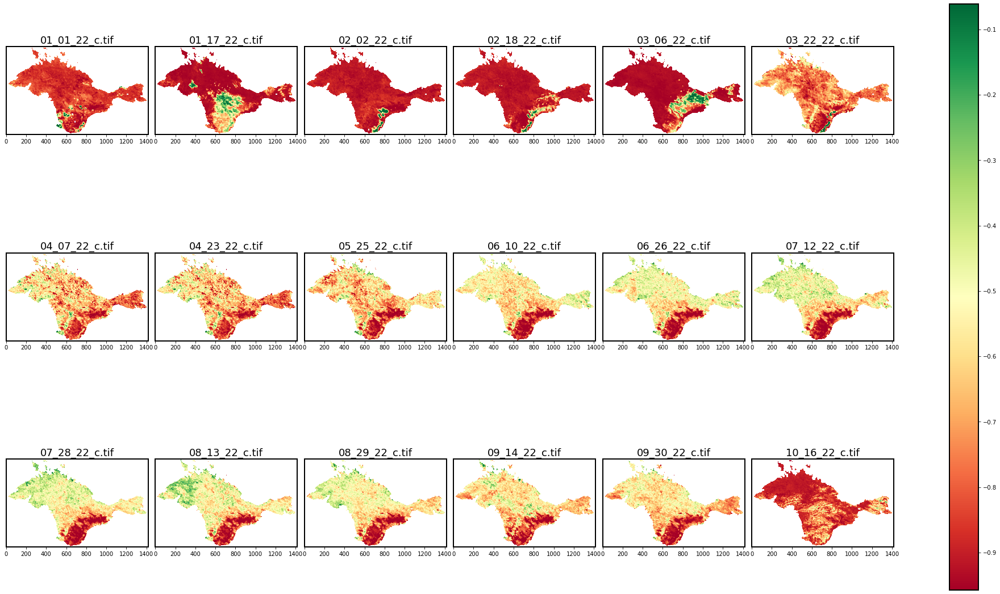

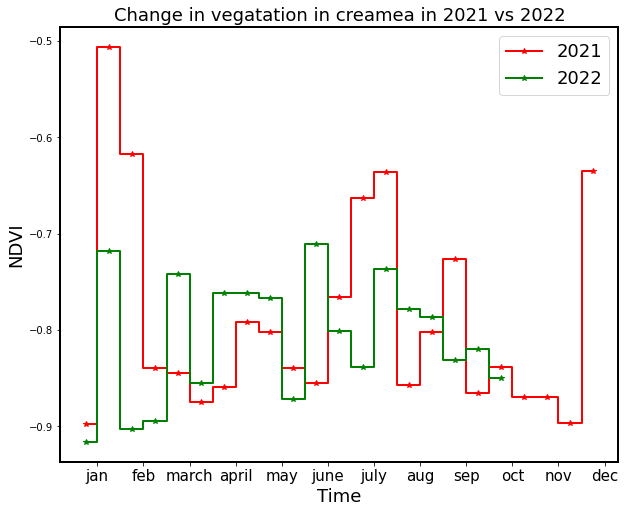

In [36]:
dt=[]
data=[]

# chnage range of i to select desired data set

for i in range(0,2,1):
  os.chdir(path[i+6])
  print(path[i+6])
  def read_files(file_path):
    with open(file_path, 'r') as file:
        print(file.read())
  # Iterate over all the files in the directory
  for file in os.listdir():
    if file.endswith('.tif'):
        # Create the filepath of particular file
        file_path=os.path.join(path[i+6],file)
        print(file_path)
        data.append(file_path)
        dt.append(file)
ds2=[]
m2=[]
std2=[]
for i in range(0,len(data),1):
    ds = gdal.Open(data[i]).ReadAsArray()
    ds[ds == 0] = np.nan
    a=np.nanmin(ds)
    b=np.nanmax(ds)
    #print(a)
    c=-1
    d=1
    e=ds-a
    f=e/(b-a)
    g=f*(d-c)
    hh=g+c
    ds2.append(hh)
    #vmin=np.nanquantile(hh,0.05)
    #vmax=np.nanquantile(hh,0.99)
    #im=axs[i].imshow(hh,vmax=vmax,vmin=vmin,cmap='RdYlGn')
    #axs[i].set_yticks([])
    mean=np.nanmean(hh)
    std=np.nanstd(hh)
    m2.append(mean)
    std2.append(std)
    #print(mean,std,i,dt[i])
mpl.rcParams['lines.linewidth'] = 2
rc('axes', linewidth=2)

fig, axs = plt.subplots(4,6, figsize=(35, 20), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = 0.2, wspace=0.05)
axs = axs.ravel()
for i in range(0,24,1):
    vmin=np.nanquantile(ds2[i],0.05)
    vmax=np.nanquantile(ds2[i],0.99)
    im=axs[i].imshow(ds2[i],vmax=vmax,  vmin=vmin,  cmap='RdYlGn')
    axs[i].set_title(dt[i],fontsize=18)
    axs[i].set_yticks([])
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.95)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/creamea_2021_vagetation_images.jpg',dpi=400)
#plt.clf()

fig, axs = plt.subplots(3,6, figsize=(35, 20), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = 0.01, wspace=0.05)
axs = axs.ravel()
for i in range(0,18,1):
      print(i,dt[i+23])
      vmin=np.nanquantile(ds2[i+23],0.05)
      vmax=np.nanquantile(ds2[i+23],0.99)
      #rc('axes', linewidth=4)
      im=axs[i].imshow(ds2[i+23],vmax=vmax,vmin=vmin,cmap='RdYlGn')
      axs[i].set_title(dt[i+23],fontsize=18)
      axs[i].set_yticks([])
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.95)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/creamea_2022_vagetation_images.jpg',dpi=400)

x=np.arange(0,23,1)
plt.figure(figsize=(10,8))
#plt.plot(x, m2[0:23], '*-',color='r')
#plt.plot(x[0:19], m2[23:len(dt)], '*-',color='green')
plt.step(x, m2[0:23],'*-', where='mid',color='r',label='2021')
#plt.errorbar(x, m2[0:23],yerr=std2[0:23])
plt.step(x[0:19], m2[23:len(dt)], '*-', where='mid',color='green',label='2022')
#plt.plot(x,m2,'*-')
plt.ylabel('NDVI',fontsize=18)
plt.xlabel('Time',fontsize=18)
plt.title('Change in vegatation in creamea in 2021 vs 2022',fontsize=18)
plt.legend(loc='upper right',fontsize=18)
plt.xticks([0.5,2.5,4.5,6.5,8.5,10.5,12.5,14.5,16.5,18.5,20.5,22.5],['jan','feb','march','april','may','june','july','aug','sep','oct','nov','dec'],fontsize=15)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/creamea_vegatation_change_21_22.jpg',dpi=400)

/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/Kyiv 21
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/Kyiv 21/2_18_21_k.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/Kyiv 21/1_1_21_k.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/Kyiv 21/1_17_21_k.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/Kyiv 21/2_2_21_k.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/Kyiv 21/3_6_21_k.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/Kyiv 21/3_22_21_k.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/Kyiv 21/4_7_21_k.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/Kyiv 21/4_23_21_k.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/Kyiv 21/5_9_21_k.tif
/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/Kyiv 21/5_25_21_k.tif
/content/drive/My Drive/PhD/c

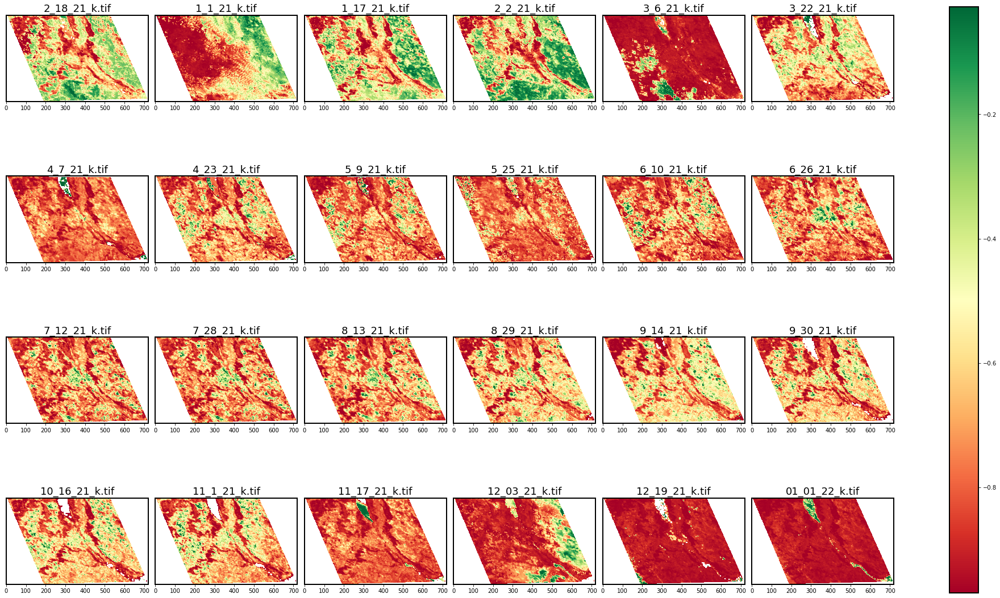

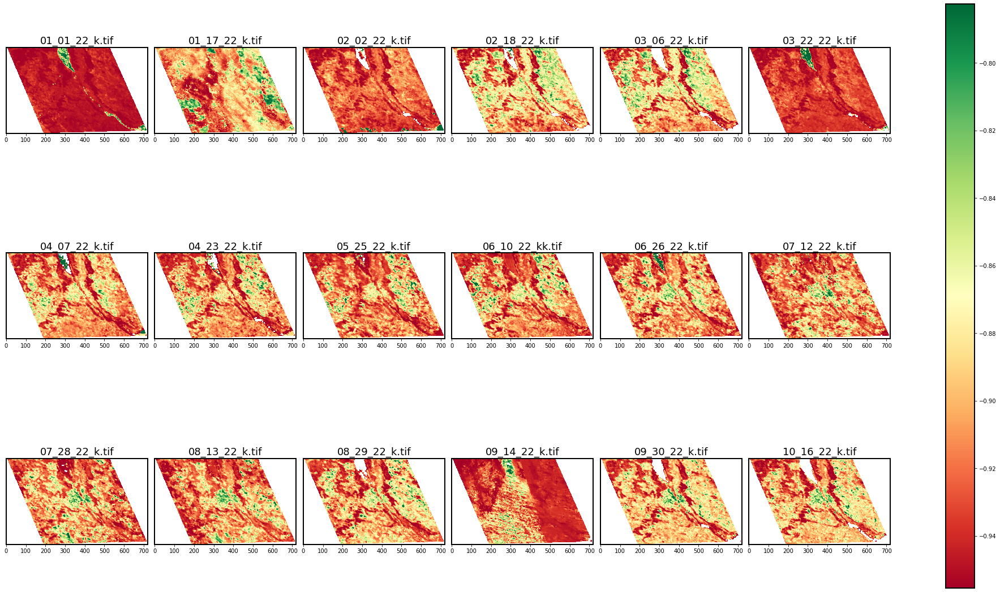

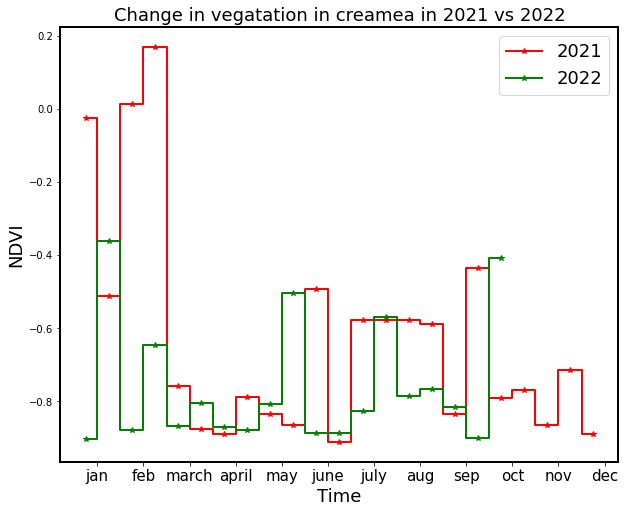

In [15]:
dt=[]
data=[]

# chnage range of i to select desired data set

for i in range(0,2,1):
  os.chdir(path[i+10])
  print(path[i+10])
  def read_files(file_path):
    with open(file_path, 'r') as file:
        print(file.read())
  # Iterate over all the files in the directory
  for file in os.listdir():
    if file.endswith('.tif'):
        # Create the filepath of particular file
        file_path=os.path.join(path[i+10],file)
        print(file_path)
        data.append(file_path)
        dt.append(file)
ds2=[]
m2=[]
std2=[]
for i in range(0,len(data),1):
    ds = gdal.Open(data[i]).ReadAsArray()
    ds[ds == 0] = np.nan
    a=np.nanmin(ds)
    b=np.nanmax(ds)
    #print(a)
    c=-1
    d=1
    e=ds-a
    f=e/(b-a)
    g=f*(d-c)
    hh=g+c
    ds2.append(hh)
    #vmin=np.nanquantile(hh,0.05)
    #vmax=np.nanquantile(hh,0.99)
    #im=axs[i].imshow(hh,vmax=vmax,vmin=vmin,cmap='RdYlGn')
    #axs[i].set_yticks([])
    mean=np.nanmean(hh)
    std=np.nanstd(hh)
    m2.append(mean)
    std2.append(std)
    #print(mean,std,i,dt[i])
mpl.rcParams['lines.linewidth'] = 2
rc('axes', linewidth=2)

fig, axs = plt.subplots(4,6, figsize=(35, 20), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = 0.2, wspace=0.05)
axs = axs.ravel()
for i in range(0,24,1):
    vmin=np.nanquantile(ds2[i],0.05)
    vmax=np.nanquantile(ds2[i],0.99)
    im=axs[i].imshow(ds2[i],vmax=vmax,  vmin=vmin,  cmap='RdYlGn')
    axs[i].set_title(dt[i],fontsize=18)
    axs[i].set_yticks([])
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.95)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/kyiv_2021_vagetation_images.jpg',dpi=400)
#plt.clf()

fig, axs = plt.subplots(3,6, figsize=(35, 20), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = 0.01, wspace=0.05)
axs = axs.ravel()
for i in range(0,18,1):
      print(i,dt[i+23])
      vmin=np.nanquantile(ds2[i+23],0.05)
      vmax=np.nanquantile(ds2[i+23],0.99)
      #rc('axes', linewidth=4)
      im=axs[i].imshow(ds2[i+23],vmax=vmax,vmin=vmin,cmap='RdYlGn')
      axs[i].set_title(dt[i+23],fontsize=18)
      axs[i].set_yticks([])
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.95)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/kyiv_2022_vagetation_images.jpg',dpi=400)

x=np.arange(0,23,1)
plt.figure(figsize=(10,8))
#plt.plot(x, m2[0:23], '*-',color='r')
#plt.plot(x[0:19], m2[23:len(dt)], '*-',color='green')
plt.step(x, m2[0:23],'*-', where='mid',color='r',label='2021')
#plt.errorbar(x, m2[0:23],yerr=std2[0:23])
plt.step(x[0:19], m2[23:len(dt)], '*-', where='mid',color='green',label='2022')
#plt.plot(x,m2,'*-')
plt.ylabel('NDVI',fontsize=18)
plt.xlabel('Time',fontsize=18)
plt.title('Change in vegatation in creamea in 2021 vs 2022',fontsize=18)
plt.legend(loc='upper right',fontsize=18)
plt.xticks([0.5,2.5,4.5,6.5,8.5,10.5,12.5,14.5,16.5,18.5,20.5,22.5],['jan','feb','march','april','may','june','july','aug','sep','oct','nov','dec'],fontsize=15)
plt.savefig('/content/drive/My Drive/PhD/course_work/2nd sem/aa407/project/data2/results/kyiv_vegatation_change_21_22.jpg',dpi=400)